# Problem Statement K-Means: To understand what items are being bought the most: Description and Quantity

In [1]:
#pip install sweetviz


# Import Dataset and Merge Pages 

In [2]:

import numpy as np
import matplotlib.pyplot as plt
import pandas as pd
import seaborn as sns
%matplotlib inline


df1 = pd.read_excel('Customer_Transactions.xlsx',0) 
df2 = pd.read_excel('Customer_Transactions.xlsx',1) 

In [3]:
import warnings
warnings.filterwarnings('ignore')

In [4]:
df1['Year'] = 2009

In [5]:
df1.head()

,Invoice,StockCode,Description,Quantity,InvoiceDate,Price,Customer ID,Country,Year
0,489434,85048,15CM CHRISTMAS GLASS BALL 20 LIGHTS,12,2009-12-01 07:45:00,6.95,13085.0,United Kingdom,2009
1,489434,79323P,PINK CHERRY LIGHTS,12,2009-12-01 07:45:00,6.75,13085.0,United Kingdom,2009
2,489434,79323W,WHITE CHERRY LIGHTS,12,2009-12-01 07:45:00,6.75,13085.0,United Kingdom,2009
3,489434,22041,"RECORD FRAME 7"" SINGLE SIZE",48,2009-12-01 07:45:00,2.10,13085.0,United Kingdom,2009
4,489434,21232,STRAWBERRY CERAMIC TRINKET BOX,24,2009-12-01 07:45:00,1.25,13085.0,United Kingdom,2009


In [6]:
df2['Year'] = 2010

In [7]:
df2.head()

,Invoice,StockCode,Description,Quantity,InvoiceDate,Price,Customer ID,Country,Year
0,536365,85123A,WHITE HANGING HEART T-LIGHT HOLDER,6,2010-12-01 08:26:00,2.55,17850.0,United Kingdom,2010
1,536365,71053,WHITE METAL LANTERN,6,2010-12-01 08:26:00,3.39,17850.0,United Kingdom,2010
2,536365,84406B,CREAM CUPID HEARTS COAT HANGER,8,2010-12-01 08:26:00,2.75,17850.0,United Kingdom,2010
3,536365,84029G,KNITTED UNION FLAG HOT WATER BOTTLE,6,2010-12-01 08:26:00,3.39,17850.0,United Kingdom,2010
4,536365,84029E,RED WOOLLY HOTTIE WHITE HEART.,6,2010-12-01 08:26:00,3.39,17850.0,United Kingdom,2010


In [8]:
cust_df = pd.concat([df1, df2])
cust_df.head()

,Invoice,StockCode,Description,Quantity,InvoiceDate,Price,Customer ID,Country,Year
0,489434,85048,15CM CHRISTMAS GLASS BALL 20 LIGHTS,12,2009-12-01 07:45:00,6.95,13085.0,United Kingdom,2009
1,489434,79323P,PINK CHERRY LIGHTS,12,2009-12-01 07:45:00,6.75,13085.0,United Kingdom,2009
2,489434,79323W,WHITE CHERRY LIGHTS,12,2009-12-01 07:45:00,6.75,13085.0,United Kingdom,2009
3,489434,22041,"RECORD FRAME 7"" SINGLE SIZE",48,2009-12-01 07:45:00,2.10,13085.0,United Kingdom,2009
4,489434,21232,STRAWBERRY CERAMIC TRINKET BOX,24,2009-12-01 07:45:00,1.25,13085.0,United Kingdom,2009


### dataframe successfully merged


# Exploratory Data Analysis 

<font color = blue> Understanding the Data 

In [9]:
#pip install dataprep



100%|##########| 3/3 [00:00<?, ?it/s]

  0%|          | 0/1618 [00:00<?, ?it/s]


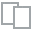
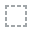
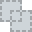
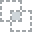
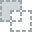
...
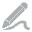
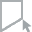
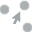
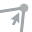
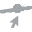

In [10]:
from dataprep.eda import create_report
report = create_report(cust_df)

report.show()

**From initial observation with dataprep, it is a large dataset, 1067371 rows, will missing values in the Customer ID and duplicate values.  There are categorical and numerical values, date time and object identifier.  The majority of sales seem to be make in the United Kingdom by a large majority, even though there are 43 countries represented..  I'll go through these step by step to evaluate the best steps of clean the data**

In [11]:
cust_df.shape

(1067371, 9)

In [12]:
cust_df.head(20)

,Invoice,StockCode,Description,Quantity,InvoiceDate,Price,Customer ID,Country,Year
0,489434,85048,15CM CHRISTMAS GLASS BALL 20 LIGHTS,12,2009-12-01 07:45:00,6.95,13085.0,United Kingdom,2009
1,489434,79323P,PINK CHERRY LIGHTS,12,2009-12-01 07:45:00,6.75,13085.0,United Kingdom,2009
2,489434,79323W,WHITE CHERRY LIGHTS,12,2009-12-01 07:45:00,6.75,13085.0,United Kingdom,2009
3,489434,22041,"RECORD FRAME 7"" SINGLE SIZE",48,2009-12-01 07:45:00,2.10,13085.0,United Kingdom,2009
4,489434,21232,STRAWBERRY CERAMIC TRINKET BOX,24,2009-12-01 07:45:00,1.25,13085.0,United Kingdom,2009
5,489434,22064,PINK DOUGHNUT TRINKET POT,24,2009-12-01 07:45:00,1.65,13085.0,United Kingdom,2009
6,489434,21871,SAVE THE PLANET MUG,24,2009-12-01 07:45:00,1.25,13085.0,United Kingdom,2009
7,489434,21523,FANCY FONT HOME SWEET HOME DOORMAT,10,2009-12-01 07:45:00,5.95,13085.0,United Kingdom,2009
8,489435,22350,CAT BOWL,12,2009-12-01 07:46:00,2.55,13085.0,United Kingdom,2009
9,489435,22349,"DOG BOWL , CHASING BALL DESIGN",12,2009-12-01 07:46:00,3.75,13085.0,United Kingdom,2009


In [13]:
cust_df.info()

<class 'pandas.core.frame.DataFrame'>
Int64Index: 1067371 entries, 0 to 541909
Data columns (total 9 columns):
 #   Column       Non-Null Count    Dtype         
---  ------       --------------    -----         
 0   Invoice      1067371 non-null  object        
 1   StockCode    1067371 non-null  object        
 2   Description  1062989 non-null  object        
 3   Quantity     1067371 non-null  int64         
 4   InvoiceDate  1067371 non-null  datetime64[ns]
 5   Price        1067371 non-null  float64       
 6   Customer ID  824364 non-null   float64       
 7   Country      1067371 non-null  object        
 8   Year         1067371 non-null  int64         
dtypes: datetime64[ns](1), float64(2), int64(2), object(4)
memory usage: 81.4+ MB


In [14]:
cust_df.describe()

,Quantity,Price,Customer ID,Year
count,1.067371e+06,1.067371e+06,824364.000000,1.067371e+06
mean,9.938898e+00,4.649388e+00,15324.638504,2.009508e+03
std,1.727058e+02,1.235531e+02,1697.464450,4.999409e-01
min,-8.099500e+04,-5.359436e+04,12346.000000,2.009000e+03
25%,1.000000e+00,1.250000e+00,13975.000000,2.009000e+03
50%,3.000000e+00,2.100000e+00,15255.000000,2.010000e+03
75%,1.000000e+01,4.150000e+00,16797.000000,2.010000e+03
max,8.099500e+04,3.897000e+04,18287.000000,2.010000e+03


In [15]:
Nan_values = cust_df.isna().sum()

print(Nan_values)

Invoice             0
StockCode           0
Description      4382
Quantity            0
InvoiceDate         0
Price               0
Customer ID    243007
Country             0
Year                0
dtype: int64


**I can see that there are minus values for quantity and price.  without a data dictionary to explain these, they will need to be removed to properly assess the data in terms of sales**

In [16]:
# I create a variable for values less than 1 in 'Quantity' and 'Price' columns
minus_values = (cust_df['Quantity'] < 1) | (cust_df['Price'] < 1)

# I drop these values 
df = cust_df[~minus_values]

In [17]:
df.describe()

,Quantity,Price,Customer ID,Year
count,836306.000000,836306.000000,627388.000000,836306.000000
mean,8.013530,4.922041,15337.723732,2009.501266
std,123.521963,57.387862,1693.467404,0.499999
min,1.000000,1.000000,12346.000000,2009.000000
25%,1.000000,1.650000,13989.000000,2009.000000
50%,3.000000,2.950000,15271.000000,2010.000000
75%,8.000000,4.950000,16812.000000,2010.000000
max,80995.000000,25111.090000,18287.000000,2010.000000


In [18]:
df.shape

(836306, 9)

In [19]:
cust_df.shape

(1067371, 9)

In [20]:
diff = ((len(cust_df)-len(df))/len(cust_df))*100
diff

21.648049272464775

**After removing the minus values, the dataset has reduced by 21.6%**

In [21]:
null_values = df.isna().sum()

print(null_values)

Invoice             0
StockCode           0
Description         0
Quantity            0
InvoiceDate         0
Price               0
Customer ID    208918
Country             0
Year                0
dtype: int64


**Nan values have been reduced but still need addressing**

### I want to look to see if there are duplicates

In [22]:
df.duplicated().sum() #to show the number of duplications

9348

In [23]:
for col in df.columns:
    dup_sum = df.duplicated(subset=col).sum()
    print(f"Duplicate sum in {col}: {dup_sum}")

Duplicate sum in Invoice: 797044
Duplicate sum in StockCode: 831787
Duplicate sum in Description: 831376
Duplicate sum in Quantity: 835890
Duplicate sum in InvoiceDate: 799806
Duplicate sum in Price: 834119
Duplicate sum in Customer ID: 830479
Duplicate sum in Country: 836263
Duplicate sum in Year: 836304


In [24]:
df.head()

,Invoice,StockCode,Description,Quantity,InvoiceDate,Price,Customer ID,Country,Year
0,489434,85048,15CM CHRISTMAS GLASS BALL 20 LIGHTS,12,2009-12-01 07:45:00,6.95,13085.0,United Kingdom,2009
1,489434,79323P,PINK CHERRY LIGHTS,12,2009-12-01 07:45:00,6.75,13085.0,United Kingdom,2009
2,489434,79323W,WHITE CHERRY LIGHTS,12,2009-12-01 07:45:00,6.75,13085.0,United Kingdom,2009
3,489434,22041,"RECORD FRAME 7"" SINGLE SIZE",48,2009-12-01 07:45:00,2.10,13085.0,United Kingdom,2009
4,489434,21232,STRAWBERRY CERAMIC TRINKET BOX,24,2009-12-01 07:45:00,1.25,13085.0,United Kingdom,2009


**It would make sense that there are duplicates in all these features, however, the duplicates in the 'Description' and 'StockCode' should be equal given one equals the other. To correct this imbalance, I want to delete 'Description' products with more than one stock code if the imbalance is not corrected through cleaning**

In [25]:
count_unique = df['Customer ID'].nunique()

print(count_unique) 

5826


In [26]:
df.head()

,Invoice,StockCode,Description,Quantity,InvoiceDate,Price,Customer ID,Country,Year
0,489434,85048,15CM CHRISTMAS GLASS BALL 20 LIGHTS,12,2009-12-01 07:45:00,6.95,13085.0,United Kingdom,2009
1,489434,79323P,PINK CHERRY LIGHTS,12,2009-12-01 07:45:00,6.75,13085.0,United Kingdom,2009
2,489434,79323W,WHITE CHERRY LIGHTS,12,2009-12-01 07:45:00,6.75,13085.0,United Kingdom,2009
3,489434,22041,"RECORD FRAME 7"" SINGLE SIZE",48,2009-12-01 07:45:00,2.10,13085.0,United Kingdom,2009
4,489434,21232,STRAWBERRY CERAMIC TRINKET BOX,24,2009-12-01 07:45:00,1.25,13085.0,United Kingdom,2009


In [27]:
null_rows = df[df['Customer ID'].isna()] 
null_rows

,Invoice,StockCode,Description,Quantity,InvoiceDate,Price,Customer ID,Country,Year
1055,489548,22271,FELTCRAFT DOLL ROSIE,1,2009-12-01 12:32:00,2.95,NaN,United Kingdom,2009
1056,489548,22254,FELT TOADSTOOL LARGE,12,2009-12-01 12:32:00,1.25,NaN,United Kingdom,2009
1057,489548,22273,FELTCRAFT DOLL MOLLY,3,2009-12-01 12:32:00,2.95,NaN,United Kingdom,2009
1058,489548,22195,LARGE HEART MEASURING SPOONS,1,2009-12-01 12:32:00,1.65,NaN,United Kingdom,2009
1059,489548,22131,FOOD CONTAINER SET 3 LOVE HEART,2,2009-12-01 12:32:00,1.95,NaN,United Kingdom,2009
...,...,...,...,...,...,...,...,...,...
541536,581498,85099B,JUMBO BAG RED RETROSPOT,5,2011-12-09 10:26:00,4.13,NaN,United Kingdom,2010
541537,581498,85099C,JUMBO BAG BAROQUE BLACK WHITE,4,2011-12-09 10:26:00,4.13,NaN,United Kingdom,2010
541538,581498,85150,LADIES & GENTLEMEN METAL SIGN,1,2011-12-09 10:26:00,4.96,NaN,United Kingdom,2010
541539,581498,85174,S/4 CACTI CANDLES,1,2011-12-09 10:26:00,10.79,NaN,United Kingdom,2010


**I want to see if I can find an invoice linked to a NaN Customer ID that may have a Customer ID and therefore I could fill them in**


**First I find the unique values of the invoices in the list of rows with NaN values in the Customer ID**

In [28]:

unique_values = null_rows['Invoice'].unique()


print(unique_values)

[489548 489596 489597 ... 581492 581497 581498]


**I can randomly check a list of any of these invoices to see if I immediately get a corresponding populated Customer Id but I will check how many there are first**

In [29]:
unique_values = len(null_rows['Invoice'].unique())
print(unique_values)

3015


In [30]:
values = len(df['Invoice'].unique())
print(values)

39262


In [31]:
percentage_null = (unique_values/values)*100
percentage_null

7.679180887372014

**There are too many unique values with a corresponding null Customer ID to go through individually, 7.7% of the total unique values, so I will spot check but check if there are any rows that do NOT have a null value**

In [32]:

# I search for the value 581492 in invoice 
filter = df['Invoice'] == '581492'
result = df[filter]

print(result)

Empty DataFrame
Columns: [Invoice, StockCode, Description, Quantity, InvoiceDate, Price, Customer ID, Country, Year]
Index: []


In [33]:
# find any rows that do not have null values
non_null_rows = null_rows.dropna()


print(non_null_rows)

Empty DataFrame
Columns: [Invoice, StockCode, Description, Quantity, InvoiceDate, Price, Customer ID, Country, Year]
Index: []


**From this I can see that there are no invoices will a corresponding Customer ID with values**

**I want to look again at the missing values as a percetage**

In [34]:
## I create a loop to scan for missing values in the dataset
features_with_na=[feature for feature in df.columns if df[feature].isnull().sum()>0]

## Here I identify the percentage of null values in the features that contain them, using a loop to iterate them using isnull(),mean() to a decimal place of 2
for feature in features_with_na:
    print(feature, np.round(df[feature].isnull().mean()*100, 2), ' % missing values')


Customer ID 24.98  % missing values


**The Customer Id has null values at nearly 25% so I would be reluctant to drop these values until I establish how it affects the entire DataFrame**<cite id="bhevk">(Frost, 2021)</cite>

In [35]:
df.shape

(836306, 9)

In [36]:
count_uniqueDes = df['Description'].nunique()

print(count_unique) 

5826


In [37]:
count_uniqueStock = df['StockCode'].nunique()

print(count_unique) 

5826


In [38]:
diff = count_uniqueDes - count_uniqueStock

**The 'Description' and the 'StockCode' are now equal**

**Ill just have another check on the other features**

In [39]:
count_unique = df['Country'].nunique()

print(count_unique) 

43


In [40]:
df['Description'].head()

0    15CM CHRISTMAS GLASS BALL 20 LIGHTS
1                     PINK CHERRY LIGHTS
2                    WHITE CHERRY LIGHTS
3           RECORD FRAME 7" SINGLE SIZE 
4         STRAWBERRY CERAMIC TRINKET BOX
Name: Description, dtype: object

In [41]:
count_unique = df['InvoiceDate'].nunique()

print(count_unique) 

36500


# Data Cleaning 


In [42]:
df.head()

,Invoice,StockCode,Description,Quantity,InvoiceDate,Price,Customer ID,Country,Year
0,489434,85048,15CM CHRISTMAS GLASS BALL 20 LIGHTS,12,2009-12-01 07:45:00,6.95,13085.0,United Kingdom,2009
1,489434,79323P,PINK CHERRY LIGHTS,12,2009-12-01 07:45:00,6.75,13085.0,United Kingdom,2009
2,489434,79323W,WHITE CHERRY LIGHTS,12,2009-12-01 07:45:00,6.75,13085.0,United Kingdom,2009
3,489434,22041,"RECORD FRAME 7"" SINGLE SIZE",48,2009-12-01 07:45:00,2.10,13085.0,United Kingdom,2009
4,489434,21232,STRAWBERRY CERAMIC TRINKET BOX,24,2009-12-01 07:45:00,1.25,13085.0,United Kingdom,2009


In [43]:
# I convert the datetime column to datetime format
df['InvoiceDate'] = pd.to_datetime(df['InvoiceDate'], format='%d/%m/%Y %H:%M')

# I remove the time portion and put in format day / month / year 
df['InvoiceDate'] = df['InvoiceDate'].dt.strftime('%d/%m/%Y')

In [44]:
df.head()

,Invoice,StockCode,Description,Quantity,InvoiceDate,Price,Customer ID,Country,Year
0,489434,85048,15CM CHRISTMAS GLASS BALL 20 LIGHTS,12,01/12/2009,6.95,13085.0,United Kingdom,2009
1,489434,79323P,PINK CHERRY LIGHTS,12,01/12/2009,6.75,13085.0,United Kingdom,2009
2,489434,79323W,WHITE CHERRY LIGHTS,12,01/12/2009,6.75,13085.0,United Kingdom,2009
3,489434,22041,"RECORD FRAME 7"" SINGLE SIZE",48,01/12/2009,2.10,13085.0,United Kingdom,2009
4,489434,21232,STRAWBERRY CERAMIC TRINKET BOX,24,01/12/2009,1.25,13085.0,United Kingdom,2009


**I'm now left with just the date which is necessary to calculate Recency for RFM**

In [45]:
null_values = df.isna().sum()

print(null_values)

Invoice             0
StockCode           0
Description         0
Quantity            0
InvoiceDate         0
Price               0
Customer ID    208918
Country             0
Year                0
dtype: int64


### Handling Outliers

In [46]:
df.describe()

,Quantity,Price,Customer ID,Year
count,836306.000000,836306.000000,627388.000000,836306.000000
mean,8.013530,4.922041,15337.723732,2009.501266
std,123.521963,57.387862,1693.467404,0.499999
min,1.000000,1.000000,12346.000000,2009.000000
25%,1.000000,1.650000,13989.000000,2009.000000
50%,3.000000,2.950000,15271.000000,2010.000000
75%,8.000000,4.950000,16812.000000,2010.000000
max,80995.000000,25111.090000,18287.000000,2010.000000


**I can see there are potential outliers in the Price column with the mean differing from the median but I will check the three**

In [47]:
df.info()

<class 'pandas.core.frame.DataFrame'>
Int64Index: 836306 entries, 0 to 541909
Data columns (total 9 columns):
 #   Column       Non-Null Count   Dtype  
---  ------       --------------   -----  
 0   Invoice      836306 non-null  object 
 1   StockCode    836306 non-null  object 
 2   Description  836306 non-null  object 
 3   Quantity     836306 non-null  int64  
 4   InvoiceDate  836306 non-null  object 
 5   Price        836306 non-null  float64
 6   Customer ID  627388 non-null  float64
 7   Country      836306 non-null  object 
 8   Year         836306 non-null  int64  
dtypes: float64(2), int64(2), object(5)
memory usage: 63.8+ MB


In [48]:
numerical = ['Price']

def detect_outliers(d):
  for i in d:
    Q3, Q1 = np.percentile(df[i], [75 ,25])
    IQR = Q3 - Q1

    ul = Q3+1.5*IQR
    ll = Q1-1.5*IQR

    outliers = cust_df[i][(cust_df[i] > ul) | (cust_df[i] < ll)]
    print(f'*** {i} outlier points***', '\n', outliers, '\n')
# This code is creating a definition to store the IQR ranges and scaan the dataframe for the numerical values to print 

In [49]:
detect_outliers(numerical)

*** Price outlier points*** 
 35          9.95
89         18.00
126       141.00
131         9.95
140        12.75
           ...  
541767     18.00
541768     18.00
541786     11.95
541852      9.95
541909     18.00
Name: Price, Length: 64504, dtype: float64 



**I can see there are outliers in 'Price' so I'll take a better look at it**

**I'll randomly select one of the rows indicated as an outlier, take it's description and visually see the differences between prices of different purchases and quantities**

In [50]:
print(df.iloc[35, :])

Invoice                          489437
StockCode                         21351
Description    CINAMMON & ORANGE WREATH
Quantity                              2
InvoiceDate                  01/12/2009
Price                              6.75
Customer ID                     15362.0
Country                  United Kingdom
Year                               2009
Name: 36, dtype: object


In [51]:

# create a new dataframe with a condition that only rows with this description contains 
new_df = df[df['Description'] == 'JOY LARGE WOOD LETTERS'].copy()


print(new_df)


       Invoice StockCode             Description  Quantity InvoiceDate  Price  \
35      489437     21360  JOY LARGE WOOD LETTERS         1  01/12/2009   9.95   
2604    489603     21360  JOY LARGE WOOD LETTERS         1  01/12/2009  21.70   
7506    490052     21360  JOY LARGE WOOD LETTERS         1  03/12/2009   9.95   
10940   490286     21360  JOY LARGE WOOD LETTERS         1  04/12/2009   9.95   
10992   490290     21360  JOY LARGE WOOD LETTERS         1  04/12/2009   9.95   
...        ...       ...                     ...       ...         ...    ...   
150015  549318     21360  JOY LARGE WOOD LETTERS         4  08/04/2011   3.95   
187070  552950     21360  JOY LARGE WOOD LETTERS         4  12/05/2011   3.95   
190363  553189     21360  JOY LARGE WOOD LETTERS         1  15/05/2011   3.95   
201369  554283     21360  JOY LARGE WOOD LETTERS         4  23/05/2011   3.95   
215428  555719     21360  JOY LARGE WOOD LETTERS         4  06/06/2011   3.95   

        Customer ID        

**Now I can see the different price values but printing the unique list and then I can compare to see if it is consitent or not between years and quantities**

In [52]:
unique_prices = new_df['Price'].value_counts().index.tolist()
print(unique_prices)

[9.95, 3.95, 21.23, 21.7, 4.8, 20.79]


In [53]:
# create a dictionary to store the randomly selected rows
result_dict = {}

# loop through each unique value in the 'Price' column
for value in new_df['Price'].unique():
    # randomly select one row with the given value
    row = new_df[new_df['Price'] == value].sample(random_state=1).iloc[0]
    # add the row to the dictionary
    result_dict[value] = row
    
# print the selected rows
for value, row in result_dict.items():
    print(f"A row with value {value}:")
    print(row)

A row with value 9.95:
Invoice                        522072
StockCode                       21360
Description    JOY LARGE WOOD LETTERS
Quantity                            1
InvoiceDate                12/09/2010
Price                            9.95
Customer ID                   14635.0
Country                United Kingdom
Year                             2009
Name: 334891, dtype: object
A row with value 21.7:
Invoice                        489603
StockCode                       21360
Description    JOY LARGE WOOD LETTERS
Quantity                            1
InvoiceDate                01/12/2009
Price                            21.7
Customer ID                       NaN
Country                United Kingdom
Year                             2009
Name: 2604, dtype: object
A row with value 3.95:
Invoice                        518233
StockCode                       21360
Description    JOY LARGE WOOD LETTERS
Quantity                           24
InvoiceDate                05/08/2010
Pri

**It clearly has no coherance and there is no explanation between the differing prices.  Therefore I need to handle these outliers and I have chosen to use interquartile range (IQR) to concentrate the spread on the middle 50% of the datapoints.  I'm using this method as it is more robust against influencing statistical distributions** <cite id="egwop">(Frost, 2021)</cite>

In [54]:
Q1 = df['Price'].quantile(0.25)
Q3 = df['Price'].quantile(0.75)
IQR = Q3 - Q1

# Count the number of outliers using computation 
outliers = df[(df['Price'] < (Q1 - 1.5 * IQR)) | (df['Price'] > (Q3 + 1.5 * IQR))]
num_outliers = len(outliers)

print("Number of outliers in 'Price' column:", num_outliers)

Number of outliers in 'Price' column: 61497


In [55]:
df_New = df[(df['Price'] >= (Q1 - 1.5 * IQR)) & (df['Price'] <= (Q3 + 1.5 * IQR))]

**The above code filters out the IQR ranges (25% and 75%), a statistical technique in the treatment of outliers.  These are removed to create a dataframe more robust to pass through a machine learning algorithm**<cite id="1c3rq">(Kharwal, 2020)</cite>


In [56]:
df_New.shape

(774809, 9)

In [57]:
df.shape

(836306, 9)

In [58]:
diff = 836306-774809
diff

61497

**I can see I've dropped 61,000 rows**

In [59]:
null_values = df_New.isna().sum()

print(null_values)

Invoice             0
StockCode           0
Description         0
Quantity            0
InvoiceDate         0
Price               0
Customer ID    181882
Country             0
Year                0
dtype: int64


In [60]:
print('Percentage of missing values in Description:', np.round(df_New['Description'].isnull().mean()*100, 2), '%')


Percentage of missing values in Description: 0.0 %


**Now I want to see what the null values in Customer_ID are still present to decide on how to deal with them**

In [61]:
null = df_New['Customer ID'].isnull().sum()
print(null)

181882


**As there is no clear way of imputing the Customer ID as examined by trying to match it to an invoice, I will drop these values**

In [62]:
df_New.dropna(subset=['Customer ID'], inplace=True)


In [63]:
df_New.shape

(592927, 9)

In [64]:
Nan_values = df_New.isna().sum()

print(Nan_values)

Invoice        0
StockCode      0
Description    0
Quantity       0
InvoiceDate    0
Price          0
Customer ID    0
Country        0
Year           0
dtype: int64


**By dropping the Customer ID Null values, it's dealt with the null Description values**

# Descriptive Statistics 

In [65]:
grouped_df = df_New.groupby('Country')['Quantity'].sum().reset_index()

# sort the grouped dataframe by 'Quantity' in ascending order
sorted_df = grouped_df.sort_values('Quantity', ascending=True)

# print the list of countries and their corresponding quantity
for index, row in sorted_df.iterrows():
    print(row['Country'], row['Quantity'])

Nigeria 23
Saudi Arabia 68
West Indies 195
Czech Republic 254
Lebanon 302
European Community 339
Brazil 408
Korea 412
Bahrain 575
RSA 718
Thailand 1190
Malta 1478
Canada 1934
Iceland 2024
Lithuania 2374
Unspecified 2774
United Arab Emirates 2871
Israel 3038
USA 3257
Singapore 3737
Poland 4148
Greece 5143
Cyprus 6851
Austria 6903
Finland 7568
Italy 8904
Channel Islands 13637
Denmark 14189
Norway 14619
Portugal 17593
Japan 17610
Belgium 18070
Sweden 29899
Switzerland 32047
Spain 35101
Australia 62532
France 108312
Germany 132986
EIRE 189442
Netherlands 243159
United Kingdom 5003327


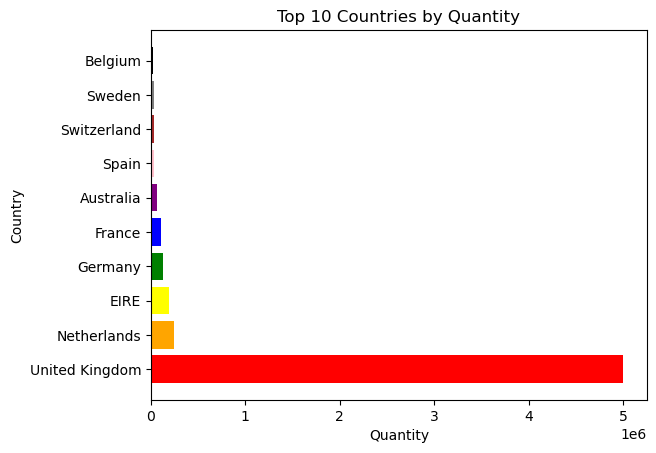

In [66]:

# sort the grouped dataframe by 'Quantity' in descending order and select the top 10 rows
sorted_df = grouped_df.nlargest(10, 'Quantity')

# create a horizontal bar chart of 'Quantity' by 'Country' for the top 10 rows
fig, ax = plt.subplots()
colors = ['red', 'orange', 'yellow', 'green', 'blue', 'purple', 'pink', 'brown', 'gray', 'black']
labels = sorted_df['Country']
values = sorted_df['Quantity']
y_pos = range(len(labels))
ax.barh(y_pos, values, color=colors)
plt.yticks(y_pos, labels)
plt.title('Top 10 Countries by Quantity')
plt.xlabel('Quantity')
plt.ylabel('Country')
plt.show()




In [67]:
grouped_df

,Country,Quantity
0,Australia,62532
1,Austria,6903
2,Bahrain,575
3,Belgium,18070
4,Brazil,408
5,Canada,1934
6,Channel Islands,13637
7,Cyprus,6851
8,Czech Republic,254
9,Denmark,14189


### I now want to store the cleaned dataframe to perform Market Basket Analysis later in the notebook

In [68]:
dfMBA  = pd.DataFrame(df_New.values, columns=df_New.columns)

In [69]:
dfMBA.to_csv('market_basket_analysis.csv', index=False)

### Encoding

**I want to cluster description and quantity sold, therefore I need to innumerate the description tab to align with the datatype for the machine learning algorithm**

In [70]:
from sklearn.preprocessing import LabelEncoder

features = ['Description', 'Country','Year']

le = LabelEncoder()

df_New[features] = df_New[features].apply(le.fit_transform)



**I used label encoding as it coverts each individual value into an integer, rather than ordinal encoding which encodes value based on their hierarchy and one hot encoding that creates a new feature**<cite id="71c1c">(Yadav, 2019)</cite>


In [71]:
df_New.info()

<class 'pandas.core.frame.DataFrame'>
Int64Index: 592927 entries, 0 to 541908
Data columns (total 9 columns):
 #   Column       Non-Null Count   Dtype  
---  ------       --------------   -----  
 0   Invoice      592927 non-null  object 
 1   StockCode    592927 non-null  object 
 2   Description  592927 non-null  int32  
 3   Quantity     592927 non-null  int64  
 4   InvoiceDate  592927 non-null  object 
 5   Price        592927 non-null  float64
 6   Customer ID  592927 non-null  float64
 7   Country      592927 non-null  int32  
 8   Year         592927 non-null  int64  
dtypes: float64(2), int32(2), int64(2), object(3)
memory usage: 40.7+ MB


# Recency / Frequency / Monetary Analysis 

**RFM analysis is a commonly used prediction method to predict and prevent customer churn by way of developing a successful e-commerce business** <cite id="jwtic">(Gupta, 2018)</cite>

**It is important that any commerce business uses their own collected, authentic data for the deployment of an RFM analysis, in most cases done through unsupervised machine learning** <cite id="g9llr">(Gupta, 2018)</cite>
    

### Creating variable for RFM Analysis 

In [72]:
df_New = df_New[['Customer ID', 'Price', 'InvoiceDate']]


In [73]:
df_New.sample()

,Customer ID,Price,InvoiceDate
66016,14646.0,2.95,21/01/2011


In [74]:
df_New.info()

<class 'pandas.core.frame.DataFrame'>
Int64Index: 592927 entries, 0 to 541908
Data columns (total 3 columns):
 #   Column       Non-Null Count   Dtype  
---  ------       --------------   -----  
 0   Customer ID  592927 non-null  float64
 1   Price        592927 non-null  float64
 2   InvoiceDate  592927 non-null  object 
dtypes: float64(2), object(1)
memory usage: 18.1+ MB


### Column for Recency

**I will do this by calculating time from the last invoice to the current date**

In [75]:
from datetime import datetime
import pandas as pd

#Indicating the format 'year-day-month'
date_format = '%d/%m/%Y'

# convert to string
date_str = df_New['InvoiceDate'].astype(str)

# convert to datetime object
date_obj = pd.to_datetime(date_str, format=date_format)

# calculate the difference between the current date and InvoiceDate
date_diff = datetime.now() - date_obj

# get the number of days from the 'date_diff' object
days = date_diff.dt.days

# create a new column with the number of days
df_New['Recency'] = days

# print the DataFrame to verify the new column has been added
print(df_New)


        Customer ID  Price InvoiceDate  Recency
0           13085.0   6.95  01/12/2009     5019
1           13085.0   6.75  01/12/2009     5019
2           13085.0   6.75  01/12/2009     5019
3           13085.0   2.10  01/12/2009     5019
4           13085.0   1.25  01/12/2009     5019
...             ...    ...         ...      ...
541903      12680.0   4.15  09/12/2011     4281
541905      12680.0   2.10  09/12/2011     4281
541906      12680.0   4.15  09/12/2011     4281
541907      12680.0   4.15  09/12/2011     4281
541908      12680.0   4.95  09/12/2011     4281

[592927 rows x 4 columns]


In [76]:
# add a new column 'Frequency' that mirrors all the values of 'Customer Id'
df_New = df_New.assign(Frequency=df_New['Customer ID'])

# display the resulting dataframe
print(df_New)

        Customer ID  Price InvoiceDate  Recency  Frequency
0           13085.0   6.95  01/12/2009     5019    13085.0
1           13085.0   6.75  01/12/2009     5019    13085.0
2           13085.0   6.75  01/12/2009     5019    13085.0
3           13085.0   2.10  01/12/2009     5019    13085.0
4           13085.0   1.25  01/12/2009     5019    13085.0
...             ...    ...         ...      ...        ...
541903      12680.0   4.15  09/12/2011     4281    12680.0
541905      12680.0   2.10  09/12/2011     4281    12680.0
541906      12680.0   4.15  09/12/2011     4281    12680.0
541907      12680.0   4.15  09/12/2011     4281    12680.0
541908      12680.0   4.95  09/12/2011     4281    12680.0

[592927 rows x 5 columns]


**I now want to merge the 'Customer ID', sum the 'Price' and take the lowest value from the 'Recency' that corresponds with that customer**

In [77]:
num_duplicates = df_New.duplicated(subset=['Customer ID']).sum()
num_duplicates

587149

**I can see here that there is a large amount of duplicates in Customer ID, so merging them to sum Price will reduce the dataset dramatically**

In [78]:
df_New = df_New.groupby('Customer ID').agg({'Price': 'sum', 'Recency': 'min', 'Frequency':'count'})




In [79]:
df_New.rename(columns={df_New.columns[0]: 'Monetary'}, inplace=True)

In [80]:
df_New.head()

,Monetary,Recency,Frequency
Customer ID,,,
12346.0,207.40,4606,34
12347.0,520.77,4283,185
12348.0,15.95,4356,12
12349.0,491.01,4299,134
12350.0,22.75,4591,13


**I am going to save this dataframe for use in grouping customers on their spend for Market Basket Analysis**

In [81]:
dfRFM = pd.DataFrame(df_New.values, columns=df_New.columns, index=df_New.index)

In [82]:
dfRFM

,Monetary,Recency,Frequency
Customer ID,,,
12346.0,207.40,4606.0,34.0
12347.0,520.77,4283.0,185.0
12348.0,15.95,4356.0,12.0
12349.0,491.01,4299.0,134.0
12350.0,22.75,4591.0,13.0
...,...,...,...
18283.0,1448.44,4284.0,694.0
18284.0,33.05,4712.0,13.0
18285.0,33.75,4941.0,8.0


In [83]:
import seaborn as sns

# create top 5 dataframe sorted by price
df_top5 = df_New.nlargest(5, 'Monetary')

# use Seaborn color palette to create the table
cm = sns.light_palette("blue", as_cmap=True)
styled_df = df_top5.style.background_gradient(cmap=cm)

# show the table
display(styled_df)



,Monetary,Recency,Frequency
Customer ID,,,
17841.000000,26950.050000,4282,9543
14911.000000,26881.600000,4282,7934
14096.000000,14556.360000,4285,4080
14606.000000,14415.740000,4282,4958
12748.000000,13467.230000,4281,4909


**I create a table to demonstrate the data produced by RFM to stakeholders** <font color = red> CITE https://pandas.pydata.org/docs/reference/api/pandas.io.formats.style.Styler.background_gradient.html

In [84]:
import pandas as pd
import numpy as np
from sklearn.preprocessing import LabelEncoder

df_New = df_New.reset_index()

le = LabelEncoder()
df_New['Customer ID'] = le.fit_transform(df_New['Customer ID'])


**I label encode 'Customer ID' for a clean numeric unique identifier**

In [85]:
df_New.head()

,Customer ID,Monetary,Recency,Frequency
0,0,207.40,4606,34
1,1,520.77,4283,185
2,2,15.95,4356,12
3,3,491.01,4299,134
4,4,22.75,4591,13


In [86]:
df_New.to_csv('RFM.csv', index=False)

### I just want to take a quick look at the maximum and minimum values of my features to see the ranges of each 

In [87]:
# find max and min values of column 'A'
max_value = df_New['Monetary'].max()
min_value = df_New['Monetary'].min()

print('Maximum value of column A:', max_value)
print('Minimum value of column A:', min_value)

Maximum value of column A: 26950.05
Minimum value of column A: 1.06


In [88]:
# find max and min values of column 'A'
max_value = df_New['Recency'].max()
min_value = df_New['Recency'].min()

print('Maximum value of column B:', max_value)
print('Minimum value of column B:', min_value)

Maximum value of column B: 5019
Minimum value of column B: 4281


In [89]:
# find max and min values of column 'A'
max_value = df_New['Frequency'].max()
min_value = df_New['Frequency'].min()

print('Maximum value of column C:', max_value)
print('Minimum value of column C:', min_value)

Maximum value of column C: 9543
Minimum value of column C: 1


<Axes: >

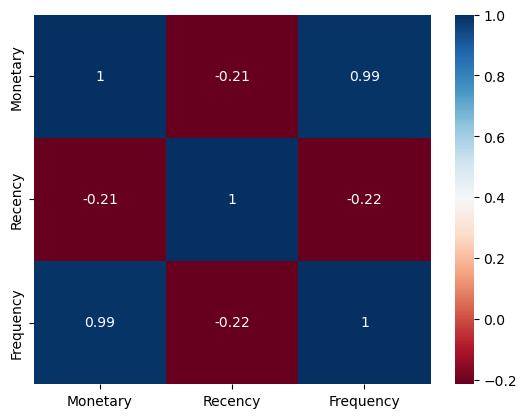

In [90]:

# calculate correlation matrix
corr_matrix = df_New[['Monetary', 'Recency', 'Frequency']].corr()

# create heatmap
sns.heatmap(corr_matrix, cmap='RdBu', annot=True)


In [91]:
corr_matrix

,Monetary,Recency,Frequency
Monetary,1.000000,-0.211600,0.989762
Recency,-0.211600,1.000000,-0.215542
Frequency,0.989762,-0.215542,1.000000


**I can see here that Monetary and Frequency have a very strong positive correlation (0.99) this suggests customers tend to make more purchases when they spend more money. I can also see that there is only a very small negative correlation between Monetary and Recency(-0.21) which suggests that there is minimal connection between a customer's spending and the time since their most recent purchase. Likewise, there is a slight negative association between frequency and recency** <cite id="iaing">(Kumar, 2022)</cite>


### I now have a dataset that I can perform clustering on how much a customer spends and when they last spent money

# Viewing the distributions of RFM

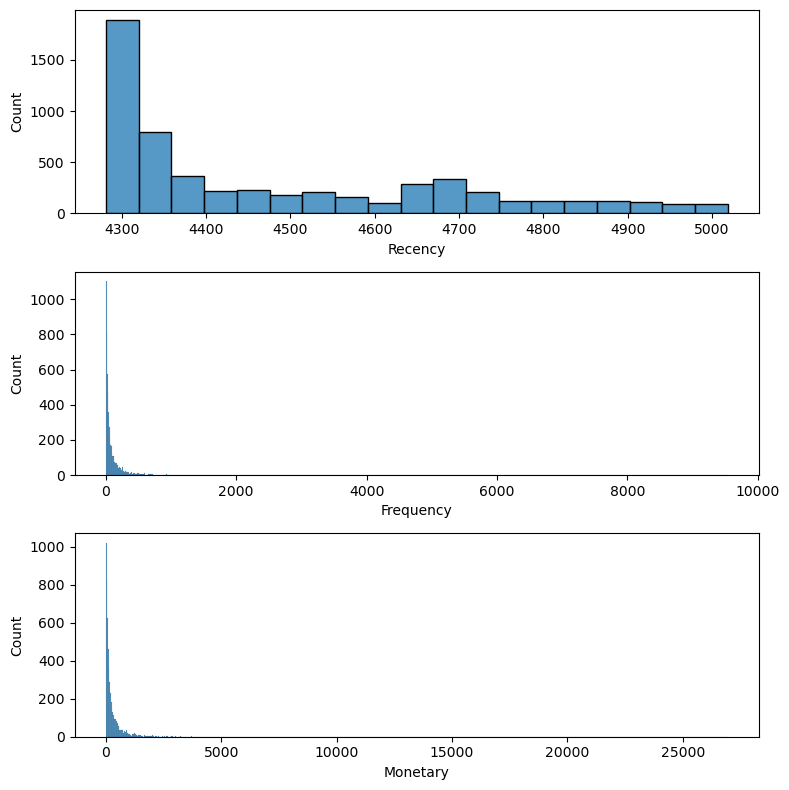

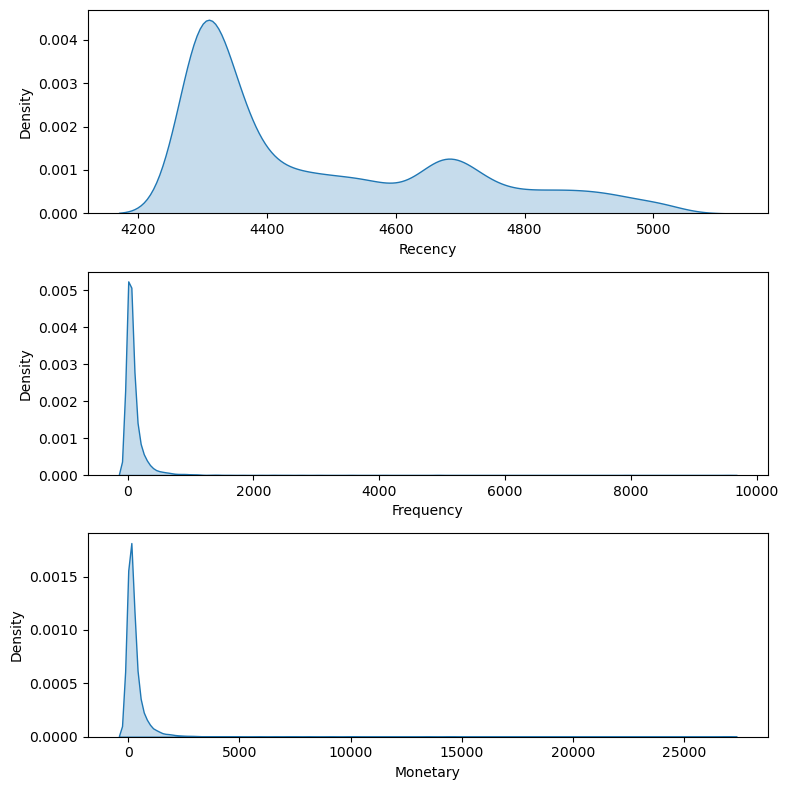

In [92]:


# plot RFM histograms
fig, ax = plt.subplots(3, 1, figsize=(8, 8))
sns.histplot(data=df_New, x='Recency', ax=ax[0])
sns.histplot(data=df_New, x='Frequency', ax=ax[1])
sns.histplot(data=df_New, x='Monetary', ax=ax[2])
plt.tight_layout()
plt.show()

# plot RFM kernel density estimates
fig, ax = plt.subplots(3, 1, figsize=(8, 8))
sns.kdeplot(data=df_New, x='Recency', ax=ax[0], shade=True)
sns.kdeplot(data=df_New, x='Frequency', ax=ax[1], shade=True)
sns.kdeplot(data=df_New, x='Monetary', ax=ax[2], shade=True)
plt.tight_layout()
plt.show()


**This data has skewness in it's distribution.  there is obviously outliers in the data so it is prudent to perform logarithmic transformation to reduce the impact of these on the data**<cite id="cn8eq">(Ryzhkov, 2020)</cite>

### Logarithmic Transformation to manage skewness 

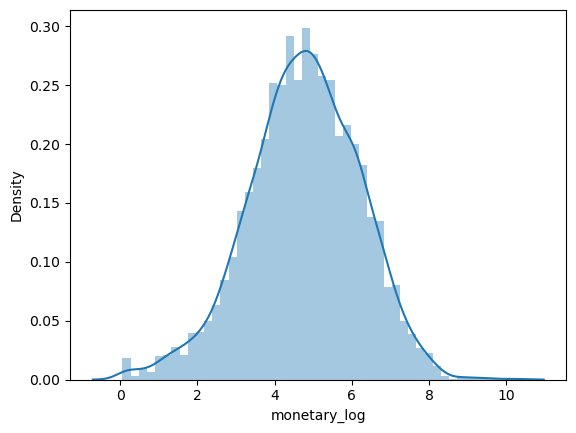

In [93]:
df_New['monetary_log'] = np.log(df_New['Monetary'])
sns.distplot(df_New['monetary_log'])
plt.show()

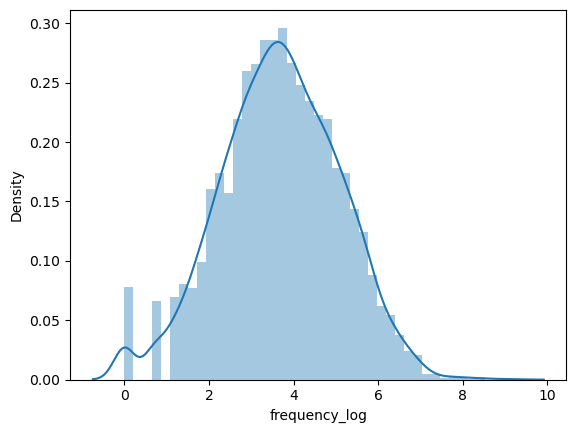

In [94]:
df_New['frequency_log'] = np.log(df_New['Frequency'])

sns.distplot(df_New['frequency_log'])

plt.show()

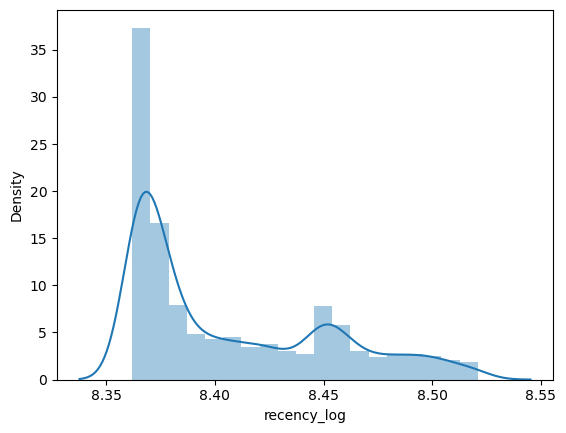

In [95]:
df_New['recency_log'] = np.log(df_New['Recency'])

sns.distplot(df_New['recency_log'])

plt.show()

<cite id="rqxbg">(Urbonas, n.d.)</cite>

In [96]:
df_New.head()

,Customer ID,Monetary,Recency,Frequency,monetary_log,frequency_log,recency_log
0,0,207.40,4606,34,5.334649,3.526361,8.435115
1,1,520.77,4283,185,6.255308,5.220356,8.362409
2,2,15.95,4356,12,2.769459,2.484907,8.379309
3,3,491.01,4299,134,6.196464,4.897840,8.366138
4,4,22.75,4591,13,3.124565,2.564949,8.431853


In [97]:
dfKM = df_New.drop(['Frequency', 'Monetary', 'Recency','Customer ID'], axis=1)

In [98]:
dfKM = dfKM.rename(columns={'frequency_log': 'Frequency', 'monetary_log': 'Monetary', 'recency_log':'Recency'})

In [99]:
dfKM.head()

,Monetary,Frequency,Recency
0,5.334649,3.526361,8.435115
1,6.255308,5.220356,8.362409
2,2.769459,2.484907,8.379309
3,6.196464,4.897840,8.366138
4,3.124565,2.564949,8.431853


# KMeans Clustering 

In [100]:
from sklearn.cluster import KMeans

In [101]:
X = dfKM.iloc[:, [0,2]].values

In [102]:
X

array([[5.3346493 , 8.43511508],
       [6.25530849, 8.36240898],
       [2.76945883, 8.37930948],
       ...,
       [3.51898042, 8.50532302],
       [5.03578309, 8.4673725 ],
       [5.57067004, 8.37170488]])

**I need to Feature Scale the data to improve the performance of k-means**

### Determining the correct number of clusters using the Elbow method 

**In the elbow method I will choose values 2, as the minimum, and I'll run though to 10 to really overshoot and provide me with the most accurate outcome**

In [103]:
wcss = []

for num in range(2, 10):
        kmeans = KMeans(n_clusters = num, max_iter=300, n_init=20, random_state=38)
        kmeans.fit(X)
        wcss.append(kmeans.inertia_)

**I chose to run the elbow method with a high max_iter value of 300 so to get a better cluster point and n_init of 20, again to give a good span for centroid seeds for a better result**<cite id="tqjpr">(PhD, 2020)</cite>


**I can now view the within-Cluster Sum of Square array**

In [104]:
wcss

[4519.425561164463,
 2364.265804141189,
 1480.341675231596,
 1006.0633541802731,
 708.275742071312,
 548.7484664424926,
 433.74742037569433,
 348.434671317939]

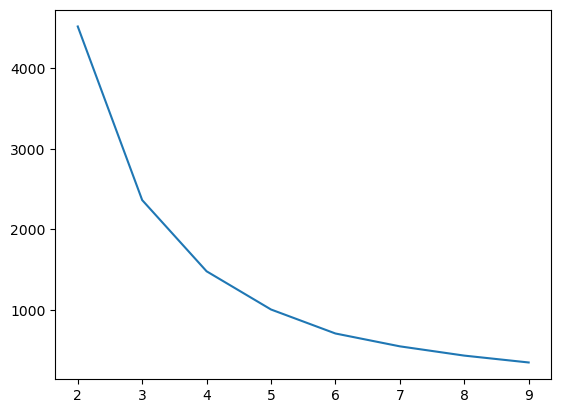

In [105]:
plt.plot(range(2,10), wcss)
plt.show()

**The most significant curve point looks to be 3 or 4**

# Silhouette Method 

In [106]:
from sklearn.metrics import silhouette_score

In [107]:
from sklearn.cluster import KMeans
from sklearn.metrics import silhouette_score


for n_clusters in range(2, 11):
    clusterer = KMeans(n_clusters=n_clusters)
    preds = clusterer.fit_predict(X)
    centers = clusterer.cluster_centers_
    score = silhouette_score(X, preds)
    print("For n_clusters = {}, silhouette score is {})".format(n_clusters, score))


For n_clusters = 2, silhouette score is 0.5462629478663045)
For n_clusters = 3, silhouette score is 0.5312936147114742)
For n_clusters = 4, silhouette score is 0.518606872754614)
For n_clusters = 5, silhouette score is 0.5133055460920944)
For n_clusters = 6, silhouette score is 0.5195360681224794)
For n_clusters = 7, silhouette score is 0.5075792991924295)
For n_clusters = 8, silhouette score is 0.5050153624559334)
For n_clusters = 9, silhouette score is 0.5085583922690146)
For n_clusters = 10, silhouette score is 0.503591622311916)


### Elbow Method and Silhouette Score Summary

**In general silhouette method is not producing overly confident scores.  But 3 clusters here is higher than 4 so I will run with 3 clusters initially but test 4 for the best results**

# K-Means Clustering 

### Recency and Monetary 

In [108]:
kmeans = KMeans(n_clusters = 3, max_iter=300, n_init=10, random_state=38)


In [109]:
y_kmeans = kmeans.fit_predict(X) # I use fit_predict to fit the data and kmeans 

In [110]:
print(y_kmeans)

[0 1 2 ... 2 0 1]


**I can see that there are 3 clusters from this array**

Text(0, 0.5, 'Recency')

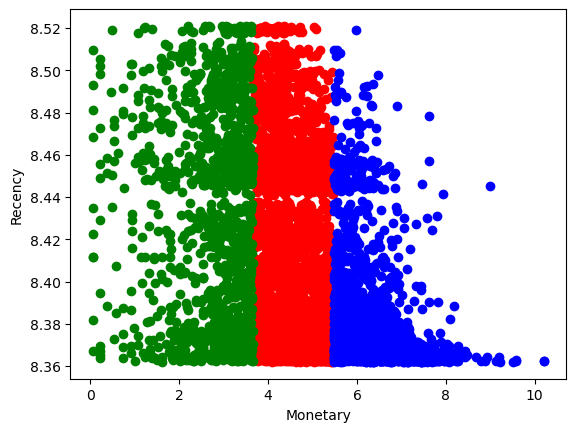

In [111]:
plt.scatter(X[y_kmeans ==0,0], X[y_kmeans ==0,1], c='red') 
plt.scatter(X[y_kmeans ==1,0], X[y_kmeans ==1,1],c='blue')
plt.scatter(X[y_kmeans ==2,0], X[y_kmeans ==2,1], c='green')


# above code
# first x[y_kmeans ==0,0] is the x value of column number and cluster number 
# second x[y_kmeans ==0,1], is the y value of column number and cluster number 

plt.xlabel("Monetary")
plt.ylabel("Recency")

**This scatter plot is not the best visualisation.  Kmeans is not as robust to outliers as other unsupervised machine learning algorithms, but this plot does give an idea as to the distribution**

**The recency of visits appears to be center in the monetary category.  This would indicate that it is the middle spenders that are the most recent.  The plot however are very closely aligned and kmeans which would indicate the points are close together or Kmeans is not performing to how I would like for a more accurate interpretation**

**I will also look at frequency and monetary**

### Frequency and Monetary

In [112]:
X2 = dfKM.iloc[:, [0,1]].values

In [113]:
wcss = []

for num in range(2, 10):
        kmeans = KMeans(n_clusters = num, max_iter=300, n_init=20, random_state=38)
        kmeans.fit(X)
        wcss.append(kmeans.inertia_)

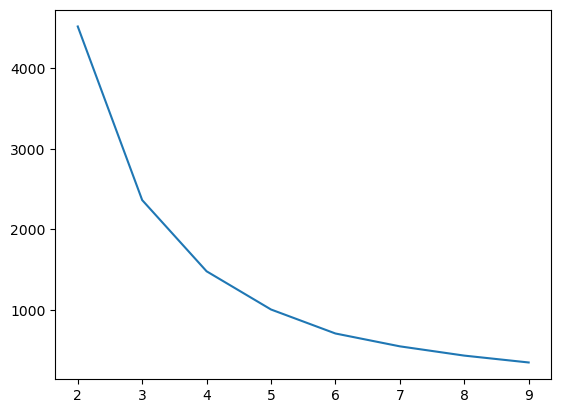

In [114]:
plt.plot(range(2,10), wcss)
plt.show()

In [115]:
kmeans = KMeans(n_clusters = 3, max_iter=300, n_init=10, random_state=38)


In [116]:
y_kmeans = kmeans.fit_predict(X) # I use fit_predict to fit the data and kmeans 

In [117]:
print(y_kmeans)

[0 1 2 ... 2 0 1]


Text(0, 0.5, 'Frequency')

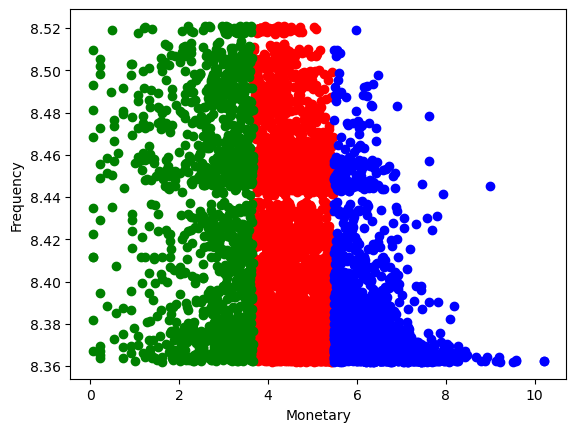

In [118]:
plt.scatter(X[y_kmeans ==0,0], X[y_kmeans ==0,1], c='red') 
plt.scatter(X[y_kmeans ==1,0], X[y_kmeans ==1,1],c='blue')
plt.scatter(X[y_kmeans ==2,0], X[y_kmeans ==2,1], c='green')


# above code
# first x[y_kmeans ==0,0] is the x value of column number and cluster number 
# second x[y_kmeans ==0,1], is the y value of column number and cluster number 

plt.xlabel("Monetary")
plt.ylabel("Frequency")

**Here I am getting a similar result with a bit more sparsity but in general, it is providing the same results of the relationship between Frequency and Monetary**

# KMedoids (Partinioning Around Medoids)

**I am going to run KMedoids as it's more robust to outliers, which it what may be distorting results in KMeans**

In [119]:
pip install scikit-learn-extra

Note: you may need to restart the kernel to use updated packages.


In [120]:
from sklearn_extra.cluster import KMedoids

In [121]:
X = dfKM.iloc[:, [0,2]]

In [122]:
X.head()

,Monetary,Recency
0,5.334649,8.435115
1,6.255308,8.362409
2,2.769459,8.379309
3,6.196464,8.366138
4,3.124565,8.431853


In [123]:
kmedoids = KMedoids(n_clusters = 3, random_state = 38)

In [124]:
centers = kmedoids.fit(X)

In [125]:
centers = kmedoids.predict(X)

In [126]:
centers

array([0, 2, 1, ..., 1, 0, 2], dtype=int64)

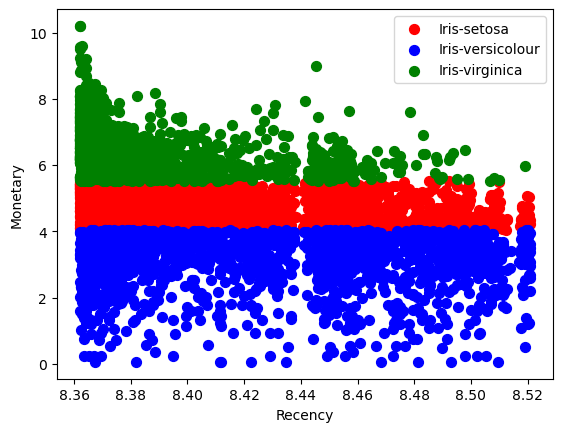

In [127]:
plt.scatter(
    X[centers == 0].Recency,
    X[centers == 0].Monetary,
    s = 50,
    c='red',
    label = 'Iris-setosa'
)

plt.scatter(
    X[centers == 1].Recency,
    X[centers == 1].Monetary,
    s = 50,
    c='blue',
    label = 'Iris-versicolour'
)

plt.scatter(
    X[centers == 2].Recency,
    X[centers == 2].Monetary,
    s = 50,
    c='green',
    label = 'Iris-virginica'
)

#plt.scatter(
#    kmeans.cluster_centers_[:,0],
#    kmeans.cluster_centers_[:,1],
#    s=50,
#    c='yellow',
#    label='Centroids'
#)
plt.legend(loc='best')
plt.xlabel('Recency')
plt.ylabel('Monetary');

**KMedoids seem to returning the same results which would suggest that the datapoints are extremely close together.  It is telling however that the most recent customers are spending the most but even if it drops off, expenditure seems to remain constant**

# Hierarchical Clustering 

**I've decided to explore Hierarchical Clustering as it is based on the concept that nearby objects are more related than object that are far away** 
    
 **In this way, it is a better able to handle metrics despite their relationships to each other** <cite id="4j83k">(CR, 2022)</cite>

In [128]:
import scipy.cluster.hierarchy as sch 

**to perform dendrogram, I need to convert string to a float, therefore I will encode the date column so I will use label encoding again**

In [129]:
X2 = dfKM.iloc[:, [0,2]].values

In [130]:
X2

array([[5.3346493 , 8.43511508],
       [6.25530849, 8.36240898],
       [2.76945883, 8.37930948],
       ...,
       [3.51898042, 8.50532302],
       [5.03578309, 8.4673725 ],
       [5.57067004, 8.37170488]])

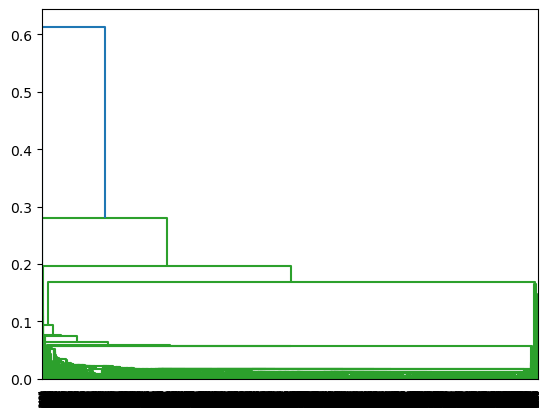

In [131]:
dendro = sch.dendrogram(sch.linkage(X2, method = 'single'))

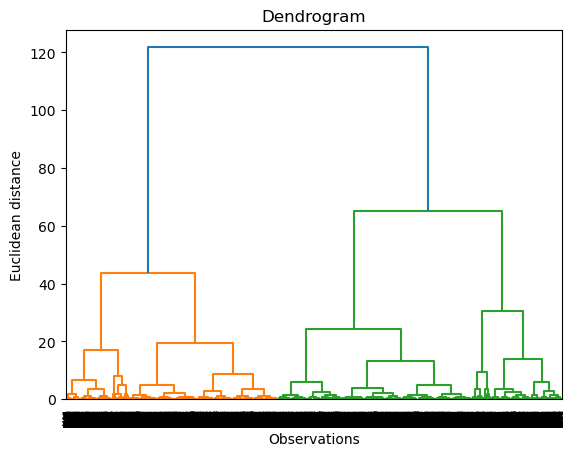

In [132]:
dendro = sch.dendrogram(sch.linkage(X2, method = 'ward'))


plt.title('Dendrogram')
plt.xlabel('Observations')
plt.ylabel('Euclidean distance')
plt.show()

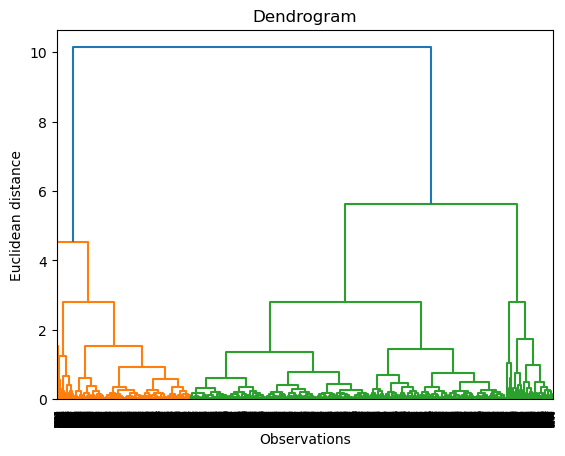

In [133]:
dendro = sch.dendrogram(sch.linkage(X2, method = 'complete'))

plt.title('Dendrogram')
plt.xlabel('Observations')
plt.ylabel('Euclidean distance')
plt.show()

### Summary

**Hierarchical clustering proved to be a more approrpiate algorithm for this data.  It partitioned the clusters into a readable format showing that the datapoints in Kmeans and Kmedoids were separate but hierarchical is more interpretable.  'Ward' method was the most accurate which is unsurprising as it's the minimal variance method.  It also identifies the relationships that were difficult to identify with Kmeans but can validate the outcomes that we drew**<cite id="c4ldr">({\em Hierarchical Cluster Analysis · UC Business Analytics R Programming Guide}, n.d.)</cite>

# Market Basket Analysis 

### Market Basket Analysis is performed to find frequent buying patterns between items to assist in marketting stratetgies such as creating 'items you might like' suggestion or bundle deals 


In [134]:
dfMBA.head()

,Invoice,StockCode,Description,Quantity,InvoiceDate,Price,Customer ID,Country,Year
0,489434,85048,15CM CHRISTMAS GLASS BALL 20 LIGHTS,12,01/12/2009,6.95,13085.0,United Kingdom,2009
1,489434,79323P,PINK CHERRY LIGHTS,12,01/12/2009,6.75,13085.0,United Kingdom,2009
2,489434,79323W,WHITE CHERRY LIGHTS,12,01/12/2009,6.75,13085.0,United Kingdom,2009
3,489434,22041,"RECORD FRAME 7"" SINGLE SIZE",48,01/12/2009,2.1,13085.0,United Kingdom,2009
4,489434,21232,STRAWBERRY CERAMIC TRINKET BOX,24,01/12/2009,1.25,13085.0,United Kingdom,2009


In [135]:
unique_values = dfMBA['Description'].nunique()

print('There are', unique_values, 'unique values in the feature column.')

There are 4204 unique values in the feature column.


In [136]:
dfMBA.shape

(592927, 9)

In [137]:
duplicates = dfMBA.duplicated('Description')

# Print the duplicate rows
print(dfMBA[duplicates])

       Invoice StockCode                      Description Quantity  \
46      489437     22111     SCOTTIE DOG HOT WATER BOTTLE        3   
72      489439     22064       PINK DOUGHNUT TRINKET POT        12   
76      489440     22350                        CAT BOWL         8   
77      489440     22349   DOG BOWL , CHASING BALL DESIGN        8   
78      489441     22138    BAKING SET 9 PIECE RETROSPOT         6   
...        ...       ...                              ...      ...   
592922  581587     23256      CHILDRENS CUTLERY SPACEBOY         4   
592923  581587     22899     CHILDREN'S APRON DOLLY GIRL         6   
592924  581587     23254    CHILDRENS CUTLERY DOLLY GIRL         4   
592925  581587     23255  CHILDRENS CUTLERY CIRCUS PARADE        4   
592926  581587     22138    BAKING SET 9 PIECE RETROSPOT         3   

       InvoiceDate Price Customer ID         Country  Year  
46      01/12/2009  4.95     15362.0  United Kingdom  2009  
72      01/12/2009  1.65     12682.0 

In [138]:
# Find all rows containing 'SCOTTIE DOG HOT WATER BOTTLE'
scottie_rows = dfMBA[dfMBA.apply(lambda row: row.astype(str).str.contains('SCOTTIE DOG HOT WATER BOTTLE').any(), axis=1)]

# Print the resulting rows
print(scottie_rows)

       Invoice StockCode                   Description Quantity InvoiceDate  \
30      489436     22111  SCOTTIE DOG HOT WATER BOTTLE       24  01/12/2009   
46      489437     22111  SCOTTIE DOG HOT WATER BOTTLE        3  01/12/2009   
80      489441     22111  SCOTTIE DOG HOT WATER BOTTLE       48  01/12/2009   
82      489442     22111  SCOTTIE DOG HOT WATER BOTTLE        3  01/12/2009   
116     489446     22111  SCOTTIE DOG HOT WATER BOTTLE        6  01/12/2009   
...        ...       ...                           ...      ...         ...   
591846  581412     22111  SCOTTIE DOG HOT WATER BOTTLE        2  08/12/2011   
592143  581427     22111  SCOTTIE DOG HOT WATER BOTTLE        3  08/12/2011   
592302  581451     22111  SCOTTIE DOG HOT WATER BOTTLE        3  08/12/2011   
592371  581456     22111  SCOTTIE DOG HOT WATER BOTTLE        4  08/12/2011   
592718  581516     22111  SCOTTIE DOG HOT WATER BOTTLE        6  09/12/2011   

       Price Customer ID         Country  Year  
30

**What I want to do here is create a dataframe with just the 'Description', 'Price' and 'Quanity' Features and merge the duplicates and suming up their corresponding quantity and price values**

In [139]:
df_items = dfMBA[['Invoice','Description', 'Quantity']]

In [140]:
df_items.head()

,Invoice,Description,Quantity
0,489434,15CM CHRISTMAS GLASS BALL 20 LIGHTS,12
1,489434,PINK CHERRY LIGHTS,12
2,489434,WHITE CHERRY LIGHTS,12
3,489434,"RECORD FRAME 7"" SINGLE SIZE",48
4,489434,STRAWBERRY CERAMIC TRINKET BOX,24


**As this is a very large dataframe, I want to break down my analysis.  Purchasing patterns will differ by country so I will narrow the search down this way.  First I'll look at the products and then I'll narrow my search by country, but I am aware that the UK is the top purchasing country.  I need to take a look at the distribution with the cleaned dataset**

<font color = red> **Top Transactions by Quantity per Country**

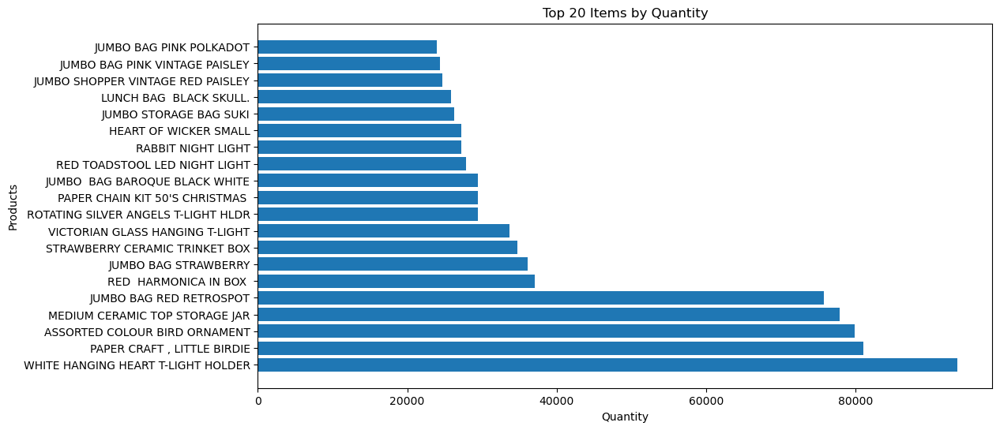

In [141]:
df_grouped = dfMBA.groupby('Description')['Quantity'].sum().reset_index()

# sort by Quantity in descending order and get top 20
top_20 = df_grouped.sort_values(by='Quantity', ascending=False)[:20]

# create bar plot with x-axis and y-axis reversed
plt.figure(figsize=(12,6))
plt.barh(top_20['Description'], top_20['Quantity'])
plt.ylabel('Products')
plt.xlabel('Quantity')
plt.title('Top 20 Items by Quantity')
plt.show()



**As expected, the UK is the leading purchasing country.  I'll concentrate MBA on this and create a UK dataframe**

### Prepare basket for analysis 

**I tried running Apriori on the datasat but it failed due to memory issues.  I took a smaller sample and that still struggled.  I decided to group customers into low / medium and high spend and run analysis on these three subsets**

**I'll group the customers using the rfm dataframe and feed that back into my original dataframe**

**The max and min values on a previous code recogised the values as**

Maximum value of column A: 26950.05
Minimum value of column A: 1.06

**Therefore I need to chose appropriate bins**

In [142]:
dfMBA.head()

,Invoice,StockCode,Description,Quantity,InvoiceDate,Price,Customer ID,Country,Year
0,489434,85048,15CM CHRISTMAS GLASS BALL 20 LIGHTS,12,01/12/2009,6.95,13085.0,United Kingdom,2009
1,489434,79323P,PINK CHERRY LIGHTS,12,01/12/2009,6.75,13085.0,United Kingdom,2009
2,489434,79323W,WHITE CHERRY LIGHTS,12,01/12/2009,6.75,13085.0,United Kingdom,2009
3,489434,22041,"RECORD FRAME 7"" SINGLE SIZE",48,01/12/2009,2.1,13085.0,United Kingdom,2009
4,489434,21232,STRAWBERRY CERAMIC TRINKET BOX,24,01/12/2009,1.25,13085.0,United Kingdom,2009


In [143]:
dfRFM.head()

,Monetary,Recency,Frequency
Customer ID,,,
12346.0,207.40,4606.0,34.0
12347.0,520.77,4283.0,185.0
12348.0,15.95,4356.0,12.0
12349.0,491.01,4299.0,134.0
12350.0,22.75,4591.0,13.0


In [144]:

# Define the bin paraemeters and labels
bin_edges = [0, 1000, 5000, float('inf')]
bin_labels = ['Low', 'Medium', 'High']

# Create a new column called Monetary_label and populate it with the appropriate label
dfRFM['SpendCategory'] = pd.cut(dfRFM['Monetary'], bins=bin_edges, labels=bin_labels)

dfRFM.head()



,Monetary,Recency,Frequency,SpendCategory
Customer ID,,,,
12346.0,207.40,4606.0,34.0,Low
12347.0,520.77,4283.0,185.0,Low
12348.0,15.95,4356.0,12.0,Low
12349.0,491.01,4299.0,134.0,Low
12350.0,22.75,4591.0,13.0,Low


In [145]:

# I Merge dfMBA and dfRFM dataframes on CustomerID column
merged_df = pd.merge(dfMBA, dfRFM, on='Customer ID')

# I Map SpendCategory values from dfRFM to dfMBA
merged_df['SpendCategory'] = merged_df['SpendCategory'].map({'Low': 'Low', 'Medium': 'Medium', 'High': 'High'})


print(merged_df.head())



  Invoice StockCode                          Description Quantity InvoiceDate  \
0  489434     85048  15CM CHRISTMAS GLASS BALL 20 LIGHTS       12  01/12/2009   
1  489434    79323P                   PINK CHERRY LIGHTS       12  01/12/2009   
2  489434    79323W                  WHITE CHERRY LIGHTS       12  01/12/2009   
3  489434     22041         RECORD FRAME 7" SINGLE SIZE        48  01/12/2009   
4  489434     21232       STRAWBERRY CERAMIC TRINKET BOX       24  01/12/2009   

  Price Customer ID         Country  Year  Monetary  Recency  Frequency  \
0  6.95     13085.0  United Kingdom  2009    294.63   4438.0       78.0   
1  6.75     13085.0  United Kingdom  2009    294.63   4438.0       78.0   
2  6.75     13085.0  United Kingdom  2009    294.63   4438.0       78.0   
3   2.1     13085.0  United Kingdom  2009    294.63   4438.0       78.0   
4  1.25     13085.0  United Kingdom  2009    294.63   4438.0       78.0   

  SpendCategory  
0           Low  
1           Low  
2       

In [146]:
 
unique_values = merged_df['SpendCategory'].unique()

# print the unique values
print(unique_values)

['Low', 'Medium', 'High']
Categories (3, object): ['Low' < 'Medium' < 'High']


In [147]:
result = merged_df.loc[merged_df['Customer ID'] == 12346]

# print the result
print(result)

       Invoice StockCode                         Description Quantity  \
204960  491725   TEST001             This is a test product.       10   
204961  491742   TEST001             This is a test product.        5   
204962  491744   TEST001             This is a test product.        5   
204963  492718   TEST001             This is a test product.        5   
204964  492722   TEST002             This is a test product.        1   
204965  493410   TEST001             This is a test product.        5   
204966  493412   TEST001             This is a test product.        5   
204967  494450   TEST001             This is a test product.        5   
204968  495295   TEST001             This is a test product.        5   
204969  499763     20682          RED SPOTTY CHILDS UMBRELLA        1   
204970  499763     20679               EDWARDIAN PARASOL RED        1   
204971  499763    15056N           EDWARDIAN PARASOL NATURAL        1   
204972  499763   15056BL             EDWARDIAN PARA

In [148]:
merged_df.shape

(592927, 13)

In [149]:
df_high = merged_df[merged_df['SpendCategory'] == 'High']
df_medium = merged_df[merged_df['SpendCategory'] == 'Medium']
df_low = merged_df[merged_df['SpendCategory'] == 'Low']

In [150]:
df_high.shape

(52487, 13)

In [151]:
df_medium.shape

(191588, 13)

In [152]:
df_low.shape

(348852, 13)

In [153]:
high = df_high.sample(n=20)
medium = df_medium.sample(n=10)
low = df_low.sample(n=7)

**I used a trial and error method to see what sample sizes would fun through Apriori and based on the sizes, I reduced them approriately**

In [154]:
high.head()

,Invoice,StockCode,Description,Quantity,InvoiceDate,Price,Customer ID,Country,Year,Monetary,Recency,Frequency,SpendCategory
118757,503064,22146,EASTER CRAFT IVY WREATH WITH CHICK,1,29/03/2010,1.95,12748.0,United Kingdom,2009,13467.23,4281.0,4909.0,High
83202,495193,84836,ZINC METAL HEART DECORATION,8,21/01/2010,1.25,14606.0,United Kingdom,2009,14415.74,4282.0,4958.0,High
177249,538799,22111,SCOTTIE DOG HOT WATER BOTTLE,3,14/12/2010,4.95,15039.0,United Kingdom,2010,7537.93,4290.0,2309.0,High
7931,538651,84946,ANTIQUE SILVER TEA GLASS ETCHED,2,13/12/2010,1.25,15311.0,United Kingdom,2010,10168.08,4281.0,3550.0,High
67887,579516,22394,PAPERWEIGHT KINGS CHOICE,2,29/11/2011,2.55,17841.0,United Kingdom,2010,26950.05,4282.0,9543.0,High


# Apriori on High Spend 

In [155]:
high['Description'] = high['Description'].str.strip()

# Dropping the rows without any invoice number
high.dropna(axis=0, subset=['Invoice'], inplace=True)
high['Invoice'] = high['Invoice'].astype('str')

HighSpend_UK = high[high['Country'] == "United Kingdom"] \
            .groupby(['Invoice', 'Description'])['Quantity'] \
            .sum().unstack().reset_index() \
            .fillna(method='ffill').set_index('Invoice')


In [156]:
HighSpend_UK.tail()

Description,ANTIQUE SILVER TEA GLASS ETCHED,CERAMIC CAKE BOWL + HANGING CAKES,CREAM CUPID HEARTS COAT HANGER,EASTER CRAFT IVY WREATH WITH CHICK,EDWARDIAN PARASOL BLACK,FRENCH FLORAL CUSHION COVER,GLITTER BUTTERFLY CLIPS,PAPERWEIGHT KINGS CHOICE,SCOTTIE DOG HOT WATER BOTTLE,SWEETHEART CAKESTAND 3 TIER,ZINC METAL HEART DECORATION
Invoice,,,,,,,,,,,
527364,NaN,1.0,12.0,1.0,6.0,NaN,1.0,NaN,NaN,12.0,8
538651,2.0,1.0,12.0,1.0,6.0,NaN,1.0,NaN,NaN,12.0,8
538799,2.0,1.0,12.0,1.0,6.0,NaN,1.0,NaN,3.0,12.0,8
569246,2.0,1.0,12.0,1.0,6.0,1.0,1.0,NaN,3.0,12.0,8
579516,2.0,1.0,12.0,1.0,6.0,1.0,1.0,2.0,3.0,12.0,8


<cite id="6fvvb">(“Implementing Apriori Algorithm in Python,” 2019)</cite>

In [157]:
HighSpend_UK.to_csv('high_spend_mba.csv')

In [158]:

# Defining the hot encoding function to make the data suitable 
# for the concerned libraries
def hot_encode(x):
    if(x<= 0):
        return 0
    if(x>= 1):
        return 1

basket_encoded = HighSpend_UK.applymap(hot_encode)
HighSpend_UK = basket_encoded
  
    

In [159]:
HighSpend_UK.head()

Description,ANTIQUE SILVER TEA GLASS ETCHED,CERAMIC CAKE BOWL + HANGING CAKES,CREAM CUPID HEARTS COAT HANGER,EASTER CRAFT IVY WREATH WITH CHICK,EDWARDIAN PARASOL BLACK,FRENCH FLORAL CUSHION COVER,GLITTER BUTTERFLY CLIPS,PAPERWEIGHT KINGS CHOICE,SCOTTIE DOG HOT WATER BOTTLE,SWEETHEART CAKESTAND 3 TIER,ZINC METAL HEART DECORATION
Invoice,,,,,,,,,,,
495193,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,1
503062,NaN,1.0,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,1
503064,NaN,1.0,NaN,1.0,NaN,NaN,NaN,NaN,NaN,NaN,1
509151,NaN,1.0,NaN,1.0,NaN,NaN,1.0,NaN,NaN,NaN,1
518787,NaN,1.0,1.0,1.0,NaN,NaN,1.0,NaN,NaN,NaN,1


In [160]:
HighSpend_UK.fillna(0, inplace = True)

In [161]:
pip install mlxtend

Note: you may need to restart the kernel to use updated packages.


In [162]:
from mlxtend.frequent_patterns import apriori, association_rules


# Get the frequent itemsets using Apriori algorithm
frequent_items_High = apriori(HighSpend_UK, min_support=0.01, use_colnames=True)
frequent_items_High



C:\Users\Administrator\anaconda3\Lib\site-packages\mlxtend\frequent_patterns\fpcommon.py:110: DeprecationWarning: DataFrames with non-bool types result in worse computationalperformance and their support might be discontinued in the future.Please use a DataFrame with bool type
  warnings.warn(


,support,itemsets
0,0.363636,(ANTIQUE SILVER TEA GLASS ETCHED)
1,0.909091,(CERAMIC CAKE BOWL + HANGING CAKES)
2,0.636364,(CREAM CUPID HEARTS COAT HANGER)
3,0.818182,(EASTER CRAFT IVY WREATH WITH CHICK)
4,0.545455,(EDWARDIAN PARASOL BLACK)
...,...,...
2042,0.090909,"(SWEETHEART CAKESTAND 3 TIER, ZINC METAL HEART..."
2043,0.090909,"(SWEETHEART CAKESTAND 3 TIER, ZINC METAL HEART..."
2044,0.090909,"(SWEETHEART CAKESTAND 3 TIER, ZINC METAL HEART..."
2045,0.090909,"(SWEETHEART CAKESTAND 3 TIER, ZINC METAL HEART..."


**I set the minimum support low as there are a lot of transactions.  I varied this but 0.01 appeared to perform the best**

**I need to choose min_support to generate my frequent items.  I can decide between trial and error so given it's a large dataset I will choose a high support so there are fewer items to access** <cite id="pmnkj">(Tutorials, n.d.)</cite>**I started low as there are lot of transactions but landed on 0.01 for best performace**

In [163]:

from mlxtend.frequent_patterns import association_rules

association_rules_high = association_rules(frequent_items_High, metric="confidence", min_threshold=0.1)


association_rules_high.head()


,antecedents,consequents,antecedent support,consequent support,support,confidence,lift,leverage,conviction,zhangs_metric
0,(CERAMIC CAKE BOWL + HANGING CAKES),(ANTIQUE SILVER TEA GLASS ETCHED),0.909091,0.363636,0.363636,0.400000,1.100000,0.033058,1.060606,1.000000
1,(ANTIQUE SILVER TEA GLASS ETCHED),(CERAMIC CAKE BOWL + HANGING CAKES),0.363636,0.909091,0.363636,1.000000,1.100000,0.033058,inf,0.142857
2,(CREAM CUPID HEARTS COAT HANGER),(ANTIQUE SILVER TEA GLASS ETCHED),0.636364,0.363636,0.363636,0.571429,1.571429,0.132231,1.484848,1.000000
3,(ANTIQUE SILVER TEA GLASS ETCHED),(CREAM CUPID HEARTS COAT HANGER),0.363636,0.636364,0.363636,1.000000,1.571429,0.132231,inf,0.571429
4,(EASTER CRAFT IVY WREATH WITH CHICK),(ANTIQUE SILVER TEA GLASS ETCHED),0.818182,0.363636,0.363636,0.444444,1.222222,0.066116,1.145455,1.000000


**There appears to be high confidence in numerous rules and low in others.  THis is indicative that the rules will translate well into any marketting strategy**

In [164]:
association_rules_high.to_csv('high_spend_Uk.csv')

# Apriori on Medium Spend

In [165]:
medium['Description'] = medium['Description'].str.strip()

# Dropping the rows without any invoice number
medium.dropna(axis=0, subset=['Invoice'], inplace=True)
medium['Invoice'] = medium['Invoice'].astype('str')

MediumSpend_UK = medium[medium['Country'] == "United Kingdom"] \
            .groupby(['Invoice', 'Description'])['Quantity'] \
            .sum().unstack().reset_index() \
            .fillna(method='ffill').set_index('Invoice')

In [166]:

# Defining the hot encoder function to make the data suitable 
# for the concerned libraries
def hot_encode(x):
    if(x<= 0):
        return 0
    if(x>= 1):
        return 1

basket_encoded = MediumSpend_UK.applymap(hot_encode)
MediumSpend_UK = basket_encoded
  

In [167]:
MediumSpend_UK.fillna(0, inplace = True)

In [168]:
from mlxtend.frequent_patterns import apriori, association_rules


# the frequent itemsets using Apriori algorithm
frequent_items_Medium = apriori(MediumSpend_UK, min_support=0.01, use_colnames=True)
frequent_items_Medium


C:\Users\Administrator\anaconda3\Lib\site-packages\mlxtend\frequent_patterns\fpcommon.py:110: DeprecationWarning: DataFrames with non-bool types result in worse computationalperformance and their support might be discontinued in the future.Please use a DataFrame with bool type
  warnings.warn(


,support,itemsets
0,0.5,(200 RED + WHITE BENDY STRAWS)
1,0.3,(DOORMAT WELCOME SUNRISE)
2,0.1,(HAND WARMER BABUSHKA DESIGN)
3,0.4,(HOT BATHS METAL SIGN)
4,0.2,(MAN FLU METAL SIGN)
...,...,...
1018,0.1,"(HAND WARMER BABUSHKA DESIGN, MAN FLU METAL SI..."
1019,0.2,"(MAN FLU METAL SIGN, SET/4 BADGES BEETLES, HOT..."
1020,0.1,"(HAND WARMER BABUSHKA DESIGN, MAN FLU METAL SI..."
1021,0.1,"(HAND WARMER BABUSHKA DESIGN, MAN FLU METAL SI..."


In [169]:

from mlxtend.frequent_patterns import association_rules

association_rules_medium = association_rules(frequent_items_Medium, metric="confidence", min_threshold=0.1)


print(association_rules_medium)


                             antecedents  \
0              (DOORMAT WELCOME SUNRISE)   
1         (200 RED + WHITE BENDY STRAWS)   
2          (HAND WARMER BABUSHKA DESIGN)   
3         (200 RED + WHITE BENDY STRAWS)   
4                 (HOT BATHS METAL SIGN)   
...                                  ...   
56997  (STRIPEY CHOCOLATE NESTING BOXES)   
56998      (TEA COSY VINTAGE UNION JACK)   
56999     (200 RED + WHITE BENDY STRAWS)   
57000        (MEMO BOARD COTTAGE DESIGN)   
57001          (DOORMAT WELCOME SUNRISE)   

                                             consequents  antecedent support  \
0                         (200 RED + WHITE BENDY STRAWS)                 0.3   
1                              (DOORMAT WELCOME SUNRISE)                 0.5   
2                         (200 RED + WHITE BENDY STRAWS)                 0.1   
3                          (HAND WARMER BABUSHKA DESIGN)                 0.5   
4                         (200 RED + WHITE BENDY STRAWS)               

In [170]:
association_rules_medium.to_csv('medium_spend_uk.csv')

# Apriori on Low Spend 

In [171]:
low['Description'] = low['Description'].str.strip()

# Dropping the rows without any invoice number
low.dropna(axis=0, subset=['Invoice'], inplace=True)
low['Invoice'] = low['Invoice'].astype('str')

LowSpend_UK = low[low['Country'] == "United Kingdom"] \
            .groupby(['Invoice', 'Description'])['Quantity'] \
            .sum().unstack().reset_index() \
            .fillna(method='ffill').set_index('Invoice')

In [172]:

# Defining the hot encoding function to make the data suitable 
# for the concerned libraries
def hot_encode(x):
    if(x<= 0):
        return 0
    if(x>= 1):
        return 1

basket_encoded = LowSpend_UK.applymap(hot_encode)
LowSpend_UK = basket_encoded
  

In [173]:
LowSpend_UK.fillna(0, inplace = True)

In [174]:
from mlxtend.frequent_patterns import apriori, association_rules


# Get the frequent itemsets using Apriori algorithm
frequent_items_low = apriori(LowSpend_UK, min_support=0.01, use_colnames=True)
frequent_items_low


C:\Users\Administrator\anaconda3\Lib\site-packages\mlxtend\frequent_patterns\fpcommon.py:110: DeprecationWarning: DataFrames with non-bool types result in worse computationalperformance and their support might be discontinued in the future.Please use a DataFrame with bool type
  warnings.warn(


,support,itemsets
0,0.714286,(ALARM CLOCK BAKELIKE GREEN)
1,0.285714,(CUPCAKE LACE PAPER SET 6)
2,0.142857,(DOORMAT SPOTTY HOME SWEET HOME)
3,1.000000,(FAIRY CAKE CANDLES)
4,0.428571,(RABBIT NIGHT LIGHT)
...,...,...
122,0.142857,"(DOORMAT SPOTTY HOME SWEET HOME, SWEETHEART CE..."
123,0.285714,"(FAIRY CAKE CANDLES, SWEETHEART CERAMIC TRINKE..."
124,0.142857,"(FAIRY CAKE CANDLES, DOORMAT SPOTTY HOME SWEET..."
125,0.142857,"(DOORMAT SPOTTY HOME SWEET HOME, FAIRY CAKE CA..."


In [175]:

from mlxtend.frequent_patterns import association_rules

association_rules_low = association_rules(frequent_items_low, metric="confidence", min_threshold=0.1)

print(association_rules_low)

                            antecedents  \
0          (ALARM CLOCK BAKELIKE GREEN)   
1            (CUPCAKE LACE PAPER SET 6)   
2          (ALARM CLOCK BAKELIKE GREEN)   
3      (DOORMAT SPOTTY HOME SWEET HOME)   
4          (ALARM CLOCK BAKELIKE GREEN)   
...                                 ...   
1927   (SWEETHEART CERAMIC TRINKET BOX)   
1928         (CUPCAKE LACE PAPER SET 6)   
1929  (WOODLAND  HEIGHT CHART STICKERS)   
1930               (RABBIT NIGHT LIGHT)   
1931       (ALARM CLOCK BAKELIKE GREEN)   

                                            consequents  antecedent support  \
0                            (CUPCAKE LACE PAPER SET 6)            0.714286   
1                          (ALARM CLOCK BAKELIKE GREEN)            0.285714   
2                      (DOORMAT SPOTTY HOME SWEET HOME)            0.714286   
3                          (ALARM CLOCK BAKELIKE GREEN)            0.142857   
4                                  (FAIRY CAKE CANDLES)            0.714286   
...      

In [176]:
association_rules_low.to_csv('low_spend_uk.csv')

# FP Growth - High Spend

In [177]:
from mlxtend.frequent_patterns import fpgrowth, association_rules

In [178]:
# fpgrowth function finds frequent items
frequent_itemsets = fpgrowth(HighSpend_UK, min_support=0.3, use_colnames=True)

# association_rules function to find rules around items bought together 
rules = association_rules(frequent_itemsets, metric='confidence', min_threshold=0.7)

print(frequent_itemsets)
rules.head()


      support                                           itemsets
0    1.000000                      (ZINC METAL HEART DECORATION)
1    0.909091                (CERAMIC CAKE BOWL + HANGING CAKES)
2    0.818182               (EASTER CRAFT IVY WREATH WITH CHICK)
3    0.727273                          (GLITTER BUTTERFLY CLIPS)
4    0.636364                   (CREAM CUPID HEARTS COAT HANGER)
..        ...                                                ...
250  0.363636  (SWEETHEART CAKESTAND 3 TIER, ZINC METAL HEART...
251  0.363636  (SWEETHEART CAKESTAND 3 TIER, ZINC METAL HEART...
252  0.363636  (SWEETHEART CAKESTAND 3 TIER, ZINC METAL HEART...
253  0.363636  (SWEETHEART CAKESTAND 3 TIER, CERAMIC CAKE BOW...
254  0.363636  (SWEETHEART CAKESTAND 3 TIER, ZINC METAL HEART...

[255 rows x 2 columns]


C:\Users\Administrator\anaconda3\Lib\site-packages\mlxtend\frequent_patterns\fpcommon.py:110: DeprecationWarning: DataFrames with non-bool types result in worse computationalperformance and their support might be discontinued in the future.Please use a DataFrame with bool type
  warnings.warn(


,antecedents,consequents,antecedent support,consequent support,support,confidence,lift,leverage,conviction,zhangs_metric
0,(CERAMIC CAKE BOWL + HANGING CAKES),(ZINC METAL HEART DECORATION),0.909091,1.000000,0.909091,1.000000,1.0,0.0,inf,0.0
1,(ZINC METAL HEART DECORATION),(CERAMIC CAKE BOWL + HANGING CAKES),1.000000,0.909091,0.909091,0.909091,1.0,0.0,1.0,0.0
2,(EASTER CRAFT IVY WREATH WITH CHICK),(ZINC METAL HEART DECORATION),0.818182,1.000000,0.818182,1.000000,1.0,0.0,inf,0.0
3,(ZINC METAL HEART DECORATION),(EASTER CRAFT IVY WREATH WITH CHICK),1.000000,0.818182,0.818182,0.818182,1.0,0.0,1.0,0.0
4,(GLITTER BUTTERFLY CLIPS),(ZINC METAL HEART DECORATION),0.727273,1.000000,0.727273,1.000000,1.0,0.0,inf,0.0


# FP Growth - Medium Spend

In [179]:

frequent_itemsets = fpgrowth(MediumSpend_UK, min_support=0.3, use_colnames=True)


rules = association_rules(frequent_itemsets, metric='confidence', min_threshold=0.7)


print(frequent_itemsets)
rules.head()


     support                                           itemsets
0        1.0                  (STRIPEY CHOCOLATE NESTING BOXES)
1        0.9                      (TEA COSY VINTAGE UNION JACK)
2        0.8                             (SET/4 BADGES BEETLES)
3        0.7                        (MEMO BOARD COTTAGE DESIGN)
4        0.6               (WHITE HANGING HEART T-LIGHT HOLDER)
..       ...                                                ...
250      0.3  (SET/4 BADGES BEETLES, HOT BATHS METAL SIGN, W...
251      0.3  (HOT BATHS METAL SIGN, WHITE HANGING HEART T-L...
252      0.3  (SET/4 BADGES BEETLES, HOT BATHS METAL SIGN, W...
253      0.3  (SET/4 BADGES BEETLES, HOT BATHS METAL SIGN, W...
254      0.3  (SET/4 BADGES BEETLES, HOT BATHS METAL SIGN, W...

[255 rows x 2 columns]


C:\Users\Administrator\anaconda3\Lib\site-packages\mlxtend\frequent_patterns\fpcommon.py:110: DeprecationWarning: DataFrames with non-bool types result in worse computationalperformance and their support might be discontinued in the future.Please use a DataFrame with bool type
  warnings.warn(


,antecedents,consequents,antecedent support,consequent support,support,confidence,lift,leverage,conviction,zhangs_metric
0,(STRIPEY CHOCOLATE NESTING BOXES),(TEA COSY VINTAGE UNION JACK),1.0,0.9,0.9,0.9,1.0,0.0,1.0,0.0
1,(TEA COSY VINTAGE UNION JACK),(STRIPEY CHOCOLATE NESTING BOXES),0.9,1.0,0.9,1.0,1.0,0.0,inf,0.0
2,(SET/4 BADGES BEETLES),(STRIPEY CHOCOLATE NESTING BOXES),0.8,1.0,0.8,1.0,1.0,0.0,inf,0.0
3,(STRIPEY CHOCOLATE NESTING BOXES),(SET/4 BADGES BEETLES),1.0,0.8,0.8,0.8,1.0,0.0,1.0,0.0
4,(MEMO BOARD COTTAGE DESIGN),(STRIPEY CHOCOLATE NESTING BOXES),0.7,1.0,0.7,1.0,1.0,0.0,inf,0.0


# FP Growth - Low Spend

In [180]:

frequent_itemsets = fpgrowth(LowSpend_UK, min_support=0.3, use_colnames=True)


rules = association_rules(frequent_itemsets, metric='confidence', min_threshold=0.7)


print(frequent_itemsets)
rules.head()

     support                                           itemsets
0   1.000000                               (FAIRY CAKE CANDLES)
1   0.857143                   (SWEETHEART CERAMIC TRINKET BOX)
2   0.714286                       (ALARM CLOCK BAKELIKE GREEN)
3   0.571429                  (WOODLAND  HEIGHT CHART STICKERS)
4   0.428571                               (RABBIT NIGHT LIGHT)
5   0.857143  (FAIRY CAKE CANDLES, SWEETHEART CERAMIC TRINKE...
6   0.714286   (ALARM CLOCK BAKELIKE GREEN, FAIRY CAKE CANDLES)
7   0.571429  (FAIRY CAKE CANDLES, WOODLAND  HEIGHT CHART ST...
8   0.428571           (RABBIT NIGHT LIGHT, FAIRY CAKE CANDLES)
9   0.714286  (ALARM CLOCK BAKELIKE GREEN, SWEETHEART CERAMI...
10  0.571429  (SWEETHEART CERAMIC TRINKET BOX, WOODLAND  HEI...
11  0.428571  (RABBIT NIGHT LIGHT, SWEETHEART CERAMIC TRINKE...
12  0.571429  (ALARM CLOCK BAKELIKE GREEN, WOODLAND  HEIGHT ...
13  0.428571   (RABBIT NIGHT LIGHT, ALARM CLOCK BAKELIKE GREEN)
14  0.428571  (RABBIT NIGHT LIGHT, WOODL

C:\Users\Administrator\anaconda3\Lib\site-packages\mlxtend\frequent_patterns\fpcommon.py:110: DeprecationWarning: DataFrames with non-bool types result in worse computationalperformance and their support might be discontinued in the future.Please use a DataFrame with bool type
  warnings.warn(


,antecedents,consequents,antecedent support,consequent support,support,confidence,lift,leverage,conviction,zhangs_metric
0,(FAIRY CAKE CANDLES),(SWEETHEART CERAMIC TRINKET BOX),1.000000,0.857143,0.857143,0.857143,1.0,0.0,1.0,0.0
1,(SWEETHEART CERAMIC TRINKET BOX),(FAIRY CAKE CANDLES),0.857143,1.000000,0.857143,1.000000,1.0,0.0,inf,0.0
2,(ALARM CLOCK BAKELIKE GREEN),(FAIRY CAKE CANDLES),0.714286,1.000000,0.714286,1.000000,1.0,0.0,inf,0.0
3,(FAIRY CAKE CANDLES),(ALARM CLOCK BAKELIKE GREEN),1.000000,0.714286,0.714286,0.714286,1.0,0.0,1.0,0.0
4,(WOODLAND HEIGHT CHART STICKERS),(FAIRY CAKE CANDLES),0.571429,1.000000,0.571429,1.000000,1.0,0.0,inf,0.0


# Bibliography

In [181]:

\begin{thebibliography}{4}
\bibitem{zotero|12244698/DH6E4Y7I}
CR, A. (2022, July 22). {\em Exploring Clustering Algorithms: Explanation and Use Cases}. Neptune.Ai. https://neptune.ai/blog/clustering-algorithms


\bibitem{zotero|12244698/84VSHQLG}
Frost, J. (2021, August 29). Interquartile Range (IQR): How to Find and Use It. {\em Statistics By Jim}. https://statisticsbyjim.com/basics/interquartile-range/


\bibitem{zotero|12244698/KQBCNYTH}
Gupta, S. (2018, July 31). Is RFM still king? A data science evaluation. {\em ReSci}. https://www.retentionscience.com/blog/rfm-king/


\bibitem{zotero|12244698/9CTNYZAT}
{\em Hierarchical Cluster Analysis · UC Business Analytics R Programming Guide}. (n.d.). Retrieved April 17, 2023, from https://uc-r.github.io/hc_clustering


\bibitem{zotero|12244698/X68JNMAX}
Implementing Apriori algorithm in Python. (2019, June 12). {\em GeeksforGeeks}. https://www.geeksforgeeks.org/implementing-apriori-algorithm-in-python/


\bibitem{zotero|12244698/R9UQT874}
Kharwal, A. (2020, December 27). {\em How to Remove Outliers in Machine Learning? | Aman Kharwal}. Thecleverprogrammer. https://thecleverprogrammer.com/2020/12/27/how-to-remove-outliers-in-machine-learning/


\bibitem{zotero|12244698/GHHIZU4E}
Kumar, A. (2022, April 16). Correlation Concepts, Matrix & Heatmap using Seaborn. {\em Data Analytics}. https://vitalflux.com/correlation-heatmap-with-seaborn-pandas/


\bibitem{zotero|12244698/7EU6MBJX}
PhD, S. K. (2020, May 11). {\em KMeans Hyper-parameters Explained with Examples}. Medium. https://towardsdatascience.com/kmeans-hyper-parameters-explained-with-examples-c93505820cd3


\bibitem{zotero|12244698/TGIWS2FA}
Ryzhkov, E. (2020, July 23). 5 Stages of Data Preprocessing for K-means clustering. {\em Medium}. https://medium.com/@evgen.ryzhkov/5-stages-of-data-preprocessing-for-k-means-clustering-b755426f9932


\bibitem{zotero|12244698/TGPXY7NI}
Tutorials, C.-A. (n.d.). {\em Market Basket Analysis in Python: An Implementation with Online Retail Data}. Deepnote. Retrieved April 17, 2023, from https://deepnote.com/@code-along-tutorials/Market-Basket-Analysis-in-Python-An-Implementation-with-Online-Retail-Data-6231620b-cba3-4935-bde8-8ce1490868bf


\bibitem{zotero|12244698/KL2XXK44}
Urbonas, K. (n.d.). {\em Data pre-processing for k- means clustering}.


\bibitem{zotero|12244698/4CNB47LD}
Yadav, D. (2019, December 9). {\em Categorical encoding using Label-Encoding and One-Hot-Encoder}. Medium. https://towardsdatascience.com/categorical-encoding-using-label-encoding-and-one-hot-encoder-911ef77fb5bd

\end{thebibliography}


SyntaxError: unexpected character after line continuation character (1947672430.py, line 1)